In [1]:
import numpy as np
import pandas as pd
import os

import imageio
import geopandas
from shapely.geometry import Point, Polygon, box
from scipy.stats import wasserstein_distance
import higra as hg

import matplotlib
import matplotlib.pyplot as plt
from matplotlib import font_manager as fm
import matplotlib.patches as mpatches
import seaborn as sns
%matplotlib inline

# Geo-Wiki User Submissions

Downloaded from https://pure.iiasa.ac.at/id/eprint/15526/.

In [4]:
csv = pd.read_csv('../mount/data/GeoWiki/participants_submissions.csv')

In [6]:
csv.head()

,submission_id,userid,timestamp,sampleid,skip_reason,submission_item_id,field_size,dominant,name,x,y
0,425137,537,31:44.1,852834,NaN,14186.0,3506.0,t,Very small (<0.64ha),10.837500,12.126022
1,425138,537,31:47.9,869707,NaN,14187.0,3507.0,f,No fields,166.887500,-15.557312
2,425139,537,31:56.4,834881,NaN,14188.0,3506.0,t,Very small (<0.64ha),113.079167,35.067688
3,425140,537,32:02.9,895601,NaN,14189.0,3504.0,t,Medium (2.56 ha -16 ha),6.312500,51.009355
4,425142,537,32:24.3,897872,NaN,14192.0,3504.0,t,Medium (2.56 ha -16 ha),-95.037500,43.026022


In [7]:
csv.shape

(488326, 11)

## All India

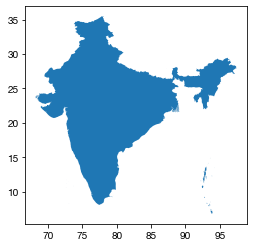

In [10]:
india = geopandas.read_file('../mount/data/gadm36_IND_shp/gadm36_IND_0.shp')

fig, ax = plt.subplots(1)
india.plot(ax=ax)
plt.show()

In [11]:
# geom = india.iloc[0]['geometry']

# in_india = []
# for i, row in csv.iterrows():
#     lon = row['x']
#     lat = row['y']
#     point = Point([lon, lat])
    
#     if point.within(geom):
#         in_india.append(True)
#     else:
#         in_india.append(False)

### Any field size

In [5]:
value_dict = {'No fields': 0, 
              'Very small (<0.64ha)': 1, 
              'Small (0.64 ha - 2.56 ha)': 2,
              'Medium (2.56 ha -16 ha)': 3, 
              'Large (16 ha - 100 ha)': 4,
              'Very large (>100 ha)': 5}
name_dict = {value_dict[y]: y for y in value_dict.keys()}

/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


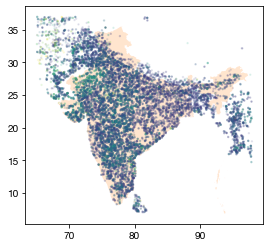

In [27]:
csv_in_india = csv[(csv['x'] > 65) & (csv['x'] < 98) &
                   (csv['y'] > 7) & (csv['y'] < 37) &
                   (csv['name'] != 'No fields')] # csv[in_india].reset_index(drop=True)
csv_in_india['name_value'] = csv_in_india['name'].map(value_dict)
fig, ax = plt.subplots(1)
india.plot(ax=ax, color='C1', alpha=0.2)
plt.scatter(csv_in_india['x'].values, csv_in_india['y'].values, s=2, 
            c=csv_in_india['name_value'], alpha=0.1, vmin=0, vmax=5) #, c=csv_in_india[''])
plt.show()

In [28]:
csv_in_india.groupby('name').size()

name
Large (16 ha - 100 ha)         384
Medium (2.56 ha -16 ha)       1987
Small (0.64 ha - 2.56 ha)     7141
Very large (>100 ha)           125
Very small (<0.64ha)         14696
dtype: int64

In [52]:
value_dict

{'No fields': 0,
 'Very small (<0.64ha)': 1,
 'Small (0.64 ha - 2.56 ha)': 2,
 'Medium (2.56 ha -16 ha)': 3,
 'Large (16 ha - 100 ha)': 4,
 'Very large (>100 ha)': 5}

/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


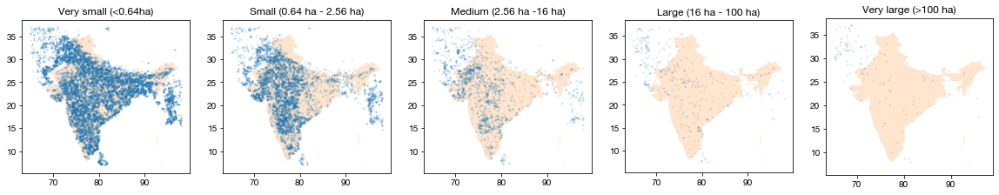

In [35]:
csv_in_india = csv[(csv['x'] > 65) & (csv['x'] < 98) &
                   (csv['y'] > 7) & (csv['y'] < 37) &
                   (csv['name'] != 'No fields')] # csv[in_india].reset_index(drop=True)
csv_in_india['name_value'] = csv_in_india['name'].map(value_dict)

ncols = 5
fig, ax = plt.subplots(1, ncols, figsize=(20, 4))

for i in range(ncols):
    india.plot(ax=ax[i], color='C1', alpha=0.2)
    ax[i].scatter(csv_in_india[csv_in_india['name_value'] == i+1]['x'].values, 
                  csv_in_india[csv_in_india['name_value'] == i+1]['y'].values, 
                  c='C0', s=2, alpha=0.1, vmin=0, vmax=5)
    ax[i].set_title(name_dict[i+1])
plt.show()

### Dominant field size

In [6]:
csv_in_india = csv[(csv['x'] > 65) & (csv['x'] < 98) &
                   (csv['y'] > 7) & (csv['y'] < 37) &
                   (csv['name'] != 'No fields')]
csv_in_india['name_value'] = csv_in_india['name'].map(value_dict)
dominant_sizes = csv_in_india[csv_in_india['dominant'] == 't'].groupby(
    ['sampleid', 'x', 'y', 'name', 'name_value']).size().reset_index()

/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [7]:
dominant_sizes = dominant_sizes.sort_values(
    ['sampleid', 0], ascending=False).drop_duplicates(
    ['sampleid']).reset_index(drop=True)

In [8]:
dominant_sizes.shape

(6539, 6)

In [12]:
geom = india.iloc[0]['geometry']

in_india = []
for i, row in dominant_sizes.iterrows():
    lon = row['x']
    lat = row['y']
    point = Point([lon, lat])
    
    if point.within(geom):
        in_india.append(True)
    else:
        in_india.append(False)

In [16]:
geowiki_dominant_india = dominant_sizes[in_india].reset_index(drop=True)

In [19]:
geowiki_dominant_india.to_csv('../mount/data/GeoWiki/geowiki_dominant-field-size_in-india.csv', index=False)

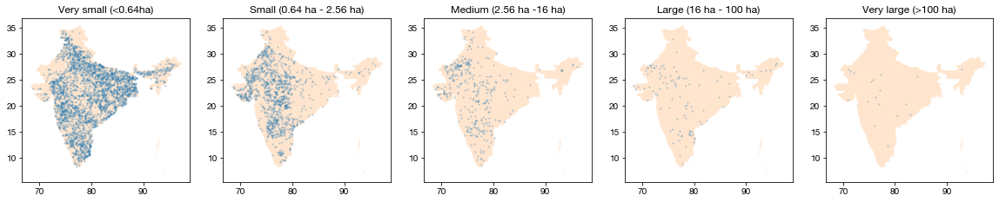

In [18]:
ncols = 5
fig, ax = plt.subplots(1, ncols, figsize=(20, 4))

for i in range(ncols):
    india.plot(ax=ax[i], color='C1', alpha=0.2)
    ax[i].scatter(geowiki_dominant_india[geowiki_dominant_india['name_value'] == i+1]['x'].values, 
                  geowiki_dominant_india[geowiki_dominant_india['name_value'] == i+1]['y'].values, 
                  c='C0', s=2, alpha=0.2, vmin=0, vmax=5)
    ax[i].set_title(name_dict[i+1])
plt.show()

In [17]:
geowiki_dominant_india.groupby('name').size()

name
Large (16 ha - 100 ha)        105
Medium (2.56 ha -16 ha)       344
Small (0.64 ha - 2.56 ha)    1150
Very large (>100 ha)           18
Very small (<0.64ha)         3068
dtype: int64

In [85]:
dominant_sizes.groupby('name').size()

name
Large (16 ha - 100 ha)        192
Medium (2.56 ha -16 ha)       533
Small (0.64 ha - 2.56 ha)    1429
Very large (>100 ha)           60
Very small (<0.64ha)         4325
dtype: int64

## Maharashtra

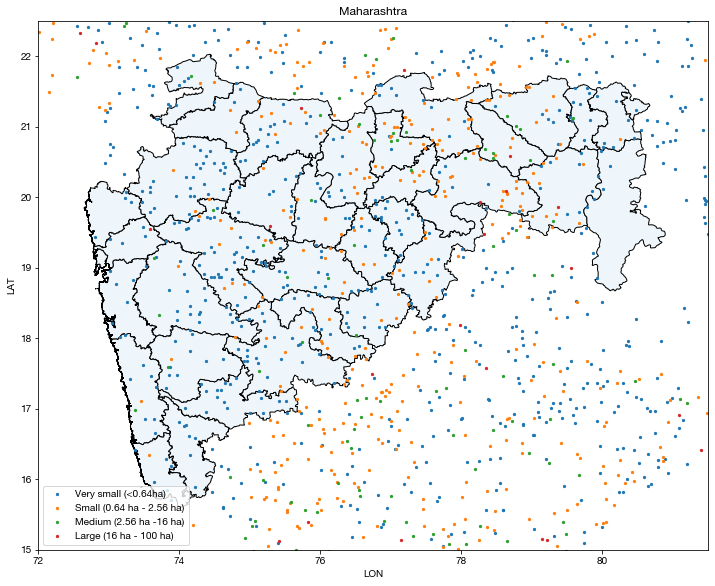

In [90]:
fig, ax = plt.subplots(1, figsize=(12, 12))

india_adm2[india_adm2['NAME_1'] == 'Maharashtra'].plot(ax=ax, edgecolor='black', color='#eef6fb')
for i in np.arange(1,5):
    plt.scatter(dominant_sizes[dominant_sizes['name_value'] == i]['x'].values, 
                dominant_sizes[dominant_sizes['name_value'] == i]['y'].values, 
                s=5, alpha=1)
plt.title('Maharashtra')
plt.xlabel('LON')
plt.ylabel('LAT')
plt.xlim([72, 81.5])
plt.ylim([15, 22.5])
plt.legend(['Very small (<0.64ha)', 'Small (0.64 ha - 2.56 ha)', 'Medium (2.56 ha -16 ha)',
            'Large (16 ha - 100 ha)', 'Very large (>100 ha)'])
plt.show()

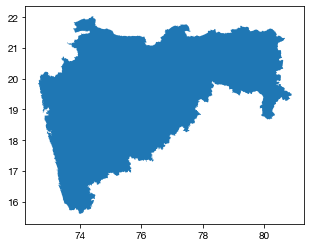

In [94]:
india_adm1 = geopandas.read_file('../mount/data/gadm36_IND_shp/gadm36_IND_1.shp')
maha = india_adm1[india_adm1['NAME_1'] == 'Maharashtra']

fig, ax = plt.subplots(1)
maha.plot(ax=ax)
plt.show()

In [96]:
geom = maha.iloc[0]['geometry']
dominant_sizes_maha = dominant_sizes[(dominant_sizes['x'] < 81) & (dominant_sizes['x'] > 72) &
                                     (dominant_sizes['y'] < 22.5) & (dominant_sizes['y'] > 15)]

in_maha = []
for i, row in dominant_sizes_maha.iterrows():
    lon = row['x']
    lat = row['y']
    point = Point([lon, lat])
    
    if point.within(geom):
        in_maha.append(True)
    else:
        in_maha.append(False)

In [118]:
# delta = 225
# dominant_sizes_maha['min_lon'] = dominant_sizes_maha['x'] - 1./(111111. * np.cos(dominant_sizes_maha['y'] * np.pi / 180.)) * delta * 3
# dominant_sizes_maha['min_lat'] = dominant_sizes_maha['y'] - 1./111111. * delta * 3
# dominant_sizes_maha['max_lon'] = dominant_sizes_maha['x'] + 1./(111111. * np.cos(dominant_sizes_maha['y'] * np.pi / 180.)) * delta * 3
# dominant_sizes_maha['max_lat'] = dominant_sizes_maha['y'] + 1./111111. * delta * 3

# dominant_sizes_maha[dominant_sizes_maha['in_maha']] = dominant_sizes_maha[dominant_sizes_maha['in_maha']]
# dominant_sizes_maha = dominant_sizes_maha.rename({'sampleid': 'image_id'}, axis=1)
dominant_sizes_maha.to_csv('../data/planet/india/geowiki/geowiki_maharashtra.csv', index=False)

In [117]:
dominant_sizes_maha.groupby('name').size()

name
Large (16 ha - 100 ha)        20
Medium (2.56 ha -16 ha)       90
Small (0.64 ha - 2.56 ha)    384
Very large (>100 ha)           5
Very small (<0.64ha)         688
dtype: int64

/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


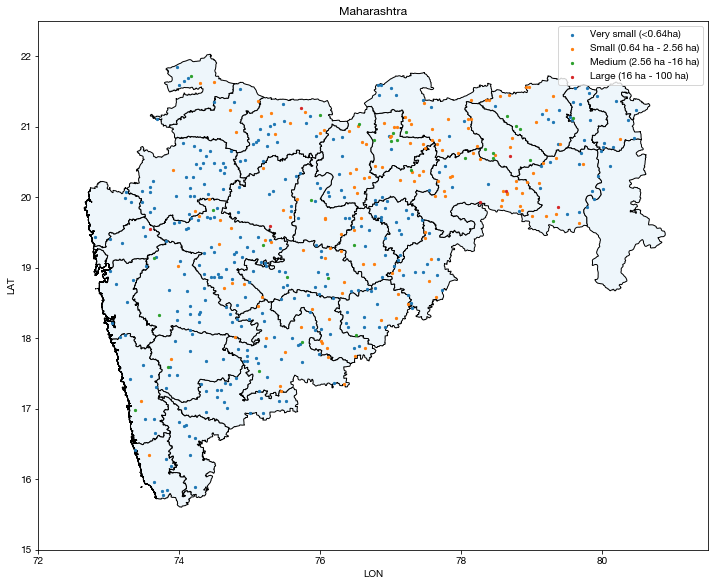

In [103]:
dominant_sizes_maha.loc[:,'in_maha'] = in_maha

fig, ax = plt.subplots(1, figsize=(12, 12))

india_adm2[india_adm2['NAME_1'] == 'Maharashtra'].plot(ax=ax, edgecolor='black', color='#eef6fb')
for i in np.arange(1,5):
    plt.scatter(dominant_sizes_maha[(dominant_sizes_maha['in_maha']) &
                                    (dominant_sizes_maha['name_value'] == i)]['x'].values, 
                dominant_sizes_maha[(dominant_sizes_maha['in_maha']) & 
                                    (dominant_sizes_maha['name_value'] == i)]['y'].values, 
                s=5, alpha=1)
plt.title('Maharashtra')
plt.xlabel('LON')
plt.ylabel('LAT')
plt.xlim([72, 81.5])
plt.ylim([15, 22.5])
plt.legend(['Very small (<0.64ha)', 'Small (0.64 ha - 2.56 ha)', 'Medium (2.56 ha -16 ha)',
            'Large (16 ha - 100 ha)', 'Very large (>100 ha)'])
plt.show()

# Visualize Planet at "Small" or larger fields

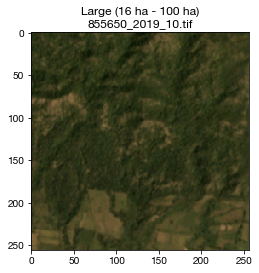

In [198]:
img_dir = '../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/'
img_names = [x for x in os.listdir(img_dir) if '_10' in x]
img_name = np.random.choice(img_names)
# good img ids: 962189, 957763, 837390, 922913, 960228
img_id = int(img_name.split('_')[0])

# dominant_sizes_maha = pd.read_csv('../data/planet/india/geowiki/geowiki_maharashtra.csv')
dominant_size = dominant_sizes_maha[dominant_sizes_maha['image_id'] == img_id]['name'].values[0]

img = imageio.imread(os.path.join(img_dir, img_name))[:256,:256]
plt.imshow(img)
plt.title(dominant_size+'\n'+img_name)
plt.show()

# Boxes to label fields in

In [199]:
df = pd.read_csv('../data/planet/india/geowiki/geowiki_maharashtra.csv')
df.head()

,image_id,x,y,name,name_value,0,in_maha,min_lon,max_lat,max_lon,min_lat
0,965377,79.354202,15.051000,Small (0.64 ha - 2.56 ha),2.0,3,False,79.347911,15.057075,79.360493,15.044925
1,965372,75.195801,18.250999,Very small (<0.64ha),1.0,2,True,75.189404,18.257075,75.202198,18.244924
2,965342,74.270798,19.742701,Small (0.64 ha - 2.56 ha),2.0,2,True,74.264343,19.748776,74.277252,19.736626
3,965144,78.545799,16.792700,Very small (<0.64ha),1.0,3,False,78.539454,16.798775,78.552145,16.786625
4,964937,75.154198,21.150999,Small (0.64 ha - 2.56 ha),2.0,3,True,75.147684,21.157074,75.160712,21.144924


In [201]:
boxes = []
for i, row in df.iterrows():
    boxes.append(box(row['min_lon'], row['min_lat'], row['max_lon'], row['max_lat']))

In [203]:
df['geometry'] = boxes
df = df[df['in_maha']].reset_index(drop=True)
geo_df = geopandas.GeoDataFrame(df, geometry='geometry')[['image_id', 'name', 'name_value', 'geometry']]
geo_df[['image_id', 'name', 'name_value', 'geometry']].to_file(
    '../data/planet/india/geowiki/geowiki_maharashtra.shp')

## Evaluate model performance

In [204]:
def InstSegm(extent, boundary, t_ext=0.4, t_bound=0.2):
    """
    INPUTS:
    extent : extent prediction
    boundary : boundary prediction
    t_ext : threshold for extent
    t_bound : threshold for boundary
    OUTPUT:
    instances
    """

    # Threshold extent mask
    ext_binary = np.uint8(extent >= t_ext)

    # Artificially create strong boundaries for
    # pixels with non-field labels
    input_hws = np.copy(boundary)
    input_hws[ext_binary == 0] = 1

    # Create the directed graph
    size = input_hws.shape[:2]
    graph = hg.get_8_adjacency_graph(size)
    edge_weights = hg.weight_graph(
        graph,
        input_hws,
        hg.WeightFunction.mean
    )

    tree, altitudes = hg.watershed_hierarchy_by_dynamics(
        graph,
        edge_weights
    )
    
    # Get individual fields
    # by cutting the graph using altitude
    instances = hg.labelisation_horizontal_cut_from_threshold(
        tree,
        altitudes,
        threshold=t_bound)
    
    instances[ext_binary == 0] = -1

    return instances

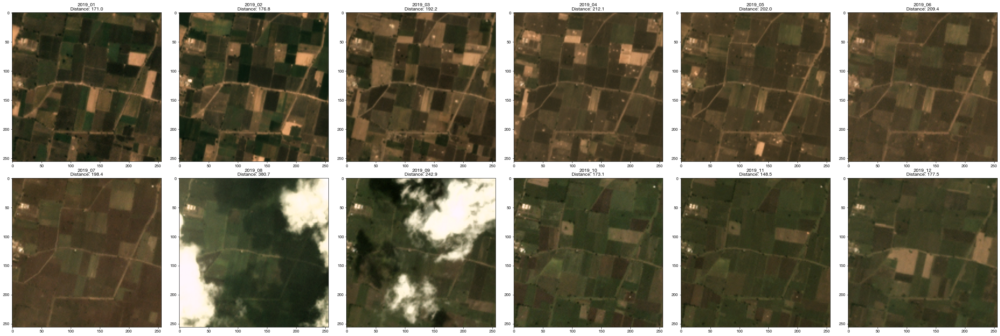

In [209]:
france_rgb_hist = np.load('../data/planet/france/sherrie10k/RGB_histogram.npy')
red_hist = france_rgb_hist[0]
green_hist = france_rgb_hist[1]
blue_hist = france_rgb_hist[2]

image_names = [str(x).zfill(5) for x in np.arange(1000) if x not in (652, 278, 904)]
# random_image_name = np.random.choice(image_names)
random_image_name = '960228'
img_dir = '../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/'
month_dirs = ['2019_{}'.format(str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(2, 6, figsize=(36, 12))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
    red_dist = wasserstein_distance(red_hist, random_image[:,:,0].flatten())
    green_dist = wasserstein_distance(green_hist, random_image[:,:,1].flatten())
    blue_dist = wasserstein_distance(blue_hist, random_image[:,2].flatten())
    total_distance = red_dist + green_dist + blue_dist
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('{}\nDistance: {:0.1f}'.format(month, total_distance))
    
plt.tight_layout()
plt.show()

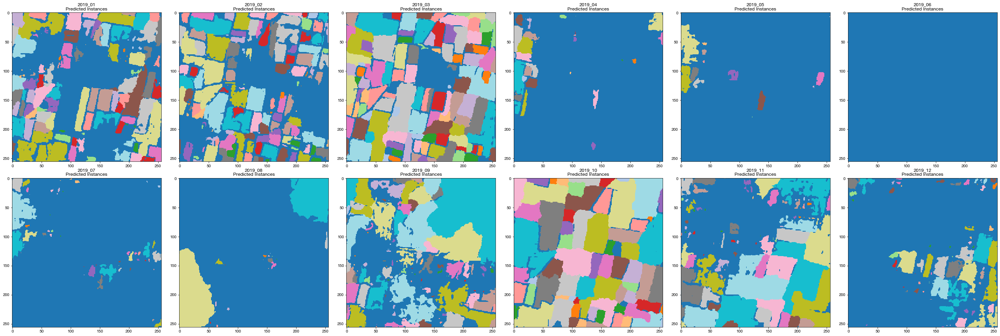

In [210]:
model_name = 'resunet-d6_aprJulOctSeparate_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_4x-downsampled/'
results_dir = '../results/india/{}/planet/'.format(model_name)
t_ext = 0.5
t_bound = 0.1

fig, ax = plt.subplots(2, 6, figsize=(36,12))
for m, month in enumerate(month_dirs):
#     example_img = imageio.imread(os.path.join(image_dir, month, '{}_{}.tif'.format(image_id, month)))[:256,:256,:3]
    example_extent = np.load(os.path.join(results_dir, month, 'extent_predictions/{}.npy'.format(random_image_name)))
    example_boundary = np.load(os.path.join(results_dir, month, 'boundary_predictions/{}.npy'.format(random_image_name)))
    
    instances = InstSegm(example_extent, example_boundary, t_ext=t_ext, t_bound=t_bound)

    # map instances to better range for plotting
    unique_instances = sorted(np.unique(instances))
    n_instances = len(unique_instances)
    instance_map = {x: i for i, x in enumerate(unique_instances)}
    def map_values(x):
        return instance_map[x]
    instances_mapped = np.array(list(map(map_values, instances.flatten()))).reshape( 
        instances.shape[0], instances.shape[1])
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(instances_mapped, vmin=0, vmax=n_instances+1, cmap='tab20')
    ax[i,j].set_title('{}\nPredicted Instances'.format(month, total_distance))

plt.tight_layout()
plt.show()

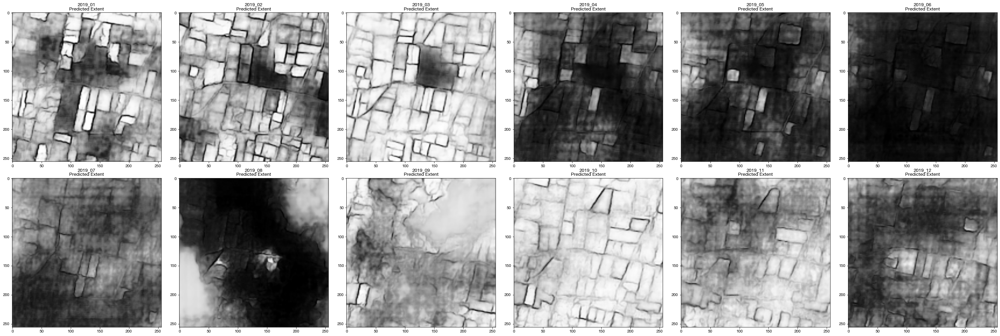

In [211]:
model_name = 'resunet-d6_aprJulOctSeparate_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_4x-downsampled/'
results_dir = '../results/india/{}/planet/'.format(model_name)
t_ext = 0.5
t_bound = 0.1

fig, ax = plt.subplots(2, 6, figsize=(36,12))
for m, month in enumerate(month_dirs):
    example_extent = np.load(os.path.join(results_dir, month, 'extent_predictions/{}.npy'.format(random_image_name)))
    example_boundary = np.load(os.path.join(results_dir, month, 'boundary_predictions/{}.npy'.format(random_image_name)))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(example_extent, vmin=0, vmax=1, cmap='Greys_r')
    ax[i,j].set_title('{}\nPredicted Extent'.format(month))

plt.tight_layout()
plt.show()

In [212]:
from sklearn.metrics import matthews_corrcoef

truth = imageio.imread('../data/planet/india/geowiki/extent_labels/960228.png')[:256,:256]
mccs = []
for m, month in enumerate(month_dirs):
    example_extent = np.load(os.path.join(results_dir, month, 'extent_predictions/{}.npy'.format(random_image_name)))
    mcc = matthews_corrcoef(truth.flatten(), example_extent.flatten() > 0.5)
    print(mcc)
    mccs.append(mcc)
print("Mean MCC:", np.mean(mccs))
print("Max MCC:", np.max(mccs))

0.13831194031476662
0.18797475725300464
0.19999221680537094
-0.06873313341074085
-0.057654265271271155


/home/swang222/anaconda3/envs/geopython/lib/python3.7/site-packages/sklearn/metrics/classification.py:872: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


0.0
-0.05463102063991992
-0.02916605394422378
0.0618564965987803
0.18090039830567411
0.0792213813992534
0.113282607828503
Mean MCC: 0.06261294376993311
Max MCC: 0.19999221680537094


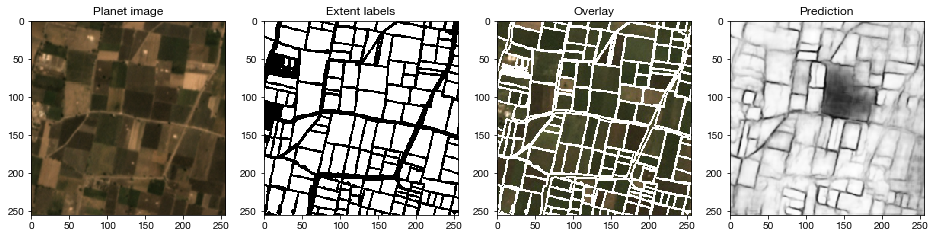

In [218]:
fig, ax = plt.subplots(1,4, figsize=(16,4))

image_id = '960228'

year_month = '2019_03'
mask = imageio.imread('../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/{}/{}.tif'.format(
    year_month, image_id + '_' + year_month))[:256,:256]
ax[0].imshow(mask)
ax[0].set_title('Planet image')

extent = imageio.imread('../data/planet/india/geowiki/extent_labels/{}.png'.format(image_id))[:256,:256]
ax[1].imshow(extent, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
ax[1].set_title('Extent labels')

overlay = imageio.imread('../data/planet/india/geowiki/overlays/{}.jpeg'.format(image_id))[:256,:256]
ax[2].imshow(overlay)
ax[2].set_title('Overlay')

pred_extent = np.load('../results/india/resunet-d6_aprJulOctSeparate_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_4x-downsampled/planet/{}/extent_predictions/{}.npy'.format(year_month, image_id))
ax[3].imshow(pred_extent, cmap='Greys_r', vmin=0, vmax=1)
ax[3].set_title('Prediction')

plt.show()

In [220]:
# consensus
months = ['2019_01', '2019_02', '2019_03', '2019_10']

def get_consensus(image_id, months, results_dir):
    preds = []
    for month in months:
        pred = np.load(os.path.join(results_dir, month, 'extent_predictions', '{}.npy'.format(image_id)))
        preds.append(pred)
    consensus = np.array(preds).mean(axis=0)
    return consensus

results_dir = '../results/india/resunet-d6_aprJulOctSeparate_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_4x-downsampled/planet/'
consensus = get_consensus(image_id, months, results_dir)

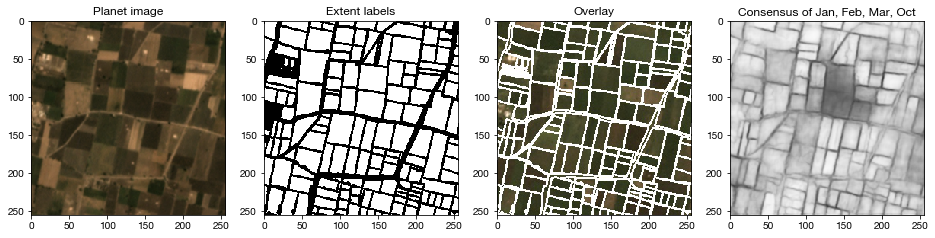

In [256]:
fig, ax = plt.subplots(1,4, figsize=(16,4))

image_id = '960228'

year_month = '2019_03'
mask = imageio.imread('../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/{}/{}.tif'.format(
    year_month, image_id + '_' + year_month))[:256,:256]
ax[0].imshow(mask)
ax[0].set_title('Planet image')

extent = imageio.imread('../data/planet/india/geowiki/extent_labels/{}.png'.format(image_id))[:256,:256]
ax[1].imshow(extent, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
ax[1].set_title('Extent labels')

overlay = imageio.imread('../data/planet/india/geowiki/overlays/{}.jpeg'.format(image_id))[:256,:256]
ax[2].imshow(overlay)
ax[2].set_title('Overlay')

ax[3].imshow(consensus, cmap='Greys_r', vmin=0, vmax=1)
ax[3].set_title('Consensus of Jan, Feb, Mar, Oct')

plt.show()

In [245]:
thresholds = np.linspace(0, 1, 101)
max_mcc = -1
best_thresh = 0.5
mccs = []
for thresh in thresholds:
    mcc = matthews_corrcoef(truth.flatten(), consensus.flatten() > thresh)
    if mcc > max_mcc:
        max_mcc = mcc
        best_thresh = thresh
    mccs.append(mcc)

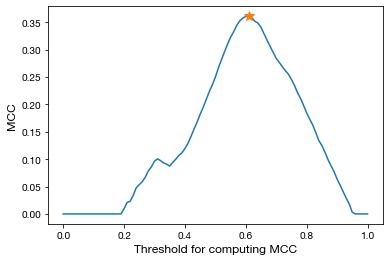

In [253]:
fs = 12
plt.plot(thresholds, mccs)
plt.plot([best_thresh], [max_mcc], '*', ms=10)
plt.xlabel('Threshold for computing MCC', fontsize=fs)
plt.ylabel('MCC', fontsize=fs)
plt.show()

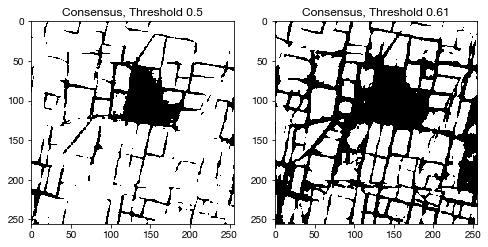

In [258]:
fig, ax = plt.subplots(1, 2, figsize=(8,4))

ax[0].imshow(consensus > 0.5, cmap='Greys_r', vmin=0, vmax=1)
ax[0].set_title('Consensus, Threshold 0.5')

ax[1].imshow(consensus > 0.61, cmap='Greys_r', vmin=0, vmax=1)
ax[1].set_title('Consensus, Threshold 0.61')

plt.show()

## Partial label France model

In [1]:
# mxnet1.6.0 env
import numpy as np
import pandas as pd
from tqdm import tqdm
import imageio
import os
from scipy.stats.stats import pearsonr
from sklearn.metrics import matthews_corrcoef

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import cv2
import mxnet as mx
from mxnet import gluon
from mxnet import autograd
from mxnet import image

import sys
sys.path.append('../../resuneta/src')
sys.path.append('../../resuneta/nn/loss')
sys.path.append('../../resuneta/models')
sys.path.append('../../')
sys.path.append('../MXNet-ResUNeta/')

from resunet_d6_causal_mtskcolor_ddist import *
from resunet_d7_causal_mtskcolor_ddist import *
from datasets import *

In [2]:
# ==================== USER SETTINGS ==================== #
n_filters = 16
n_classes = 1
hsv_channels = 3
gpu = 0

model_name = 'resunet-d6_2019_10_nfilter-16_bs-8_lr-0.001_4x-downsampled_allfield_n6759/'
file_name = '../experiments/partial-france/{}/model.params'.format(model_name)

model = ResUNet_d6(_nfilters_init=n_filters, 
                   _NClasses=n_classes,
                   hsv_outchannels=hsv_channels)
model.load_parameters(file_name, ctx=mx.gpu(gpu)) # mx.cpu())

depth:= 0, nfilters: 16
depth:= 1, nfilters: 32
depth:= 2, nfilters: 64
depth:= 3, nfilters: 128
depth:= 4, nfilters: 256
depth:= 5, nfilters: 512
depth:= 6, nfilters: 256
depth:= 7, nfilters: 128
depth:= 8, nfilters: 64
depth:= 9, nfilters: 32
depth:= 10, nfilters: 16


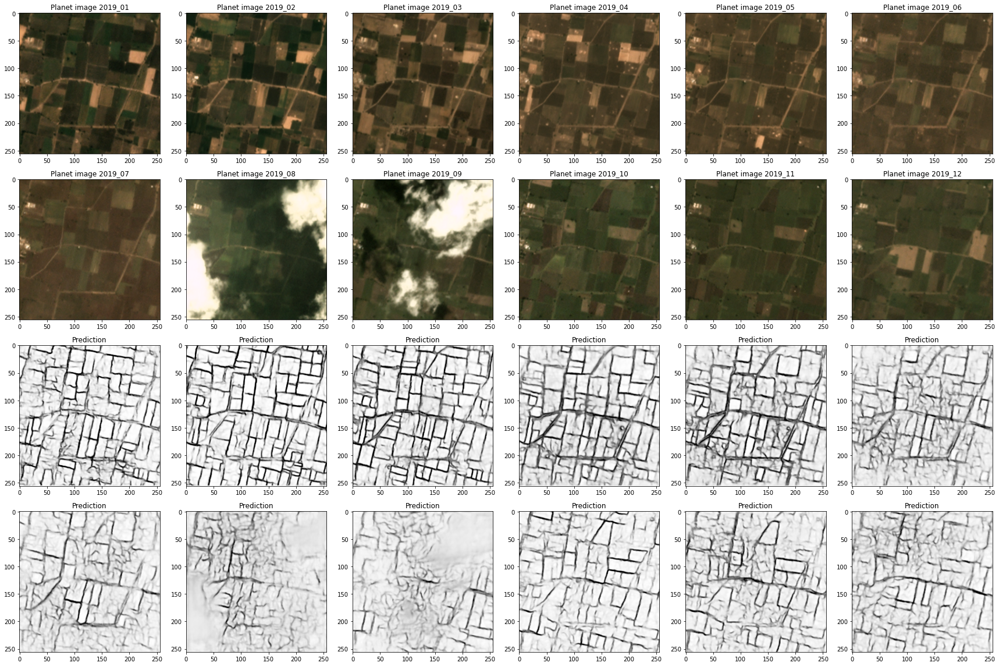

In [14]:
random_image_name = '960228'
img_dir = '../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/'
month_dirs = ['2019_{}'.format(str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
    img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
    img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
    logits, bound, dist, convc = model(img)
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(logits.asnumpy()[0][0], vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

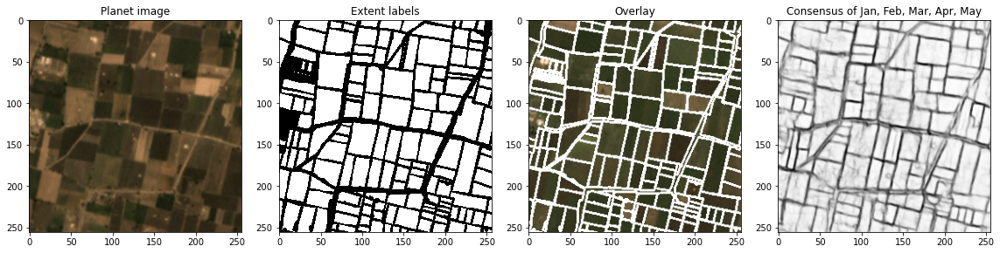

In [17]:
# consensus
image_id = '960228'
img_dir = '../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/'
month_dirs = ['2019_{}'.format(str(x+1).zfill(2)) for x in range(12)]

consensus = np.zeros((256, 256))
for m, month in enumerate(month_dirs[:5]):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
    img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
    img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
    logits, _, _, _ = model(img)
    
    consensus = consensus + logits.asnumpy()[0,0]
    
consensus = consensus / 5

fig, ax = plt.subplots(1,4, figsize=(16,4))

year_month = '2019_03'
mask = imageio.imread('../data/planet/india/geowiki/monthly_mosaics_renamed_clipped_merged/{}/{}.tif'.format(
    year_month, image_id + '_' + year_month))[:256,:256]
ax[0].imshow(mask)
ax[0].set_title('Planet image')

extent = imageio.imread('../data/planet/india/geowiki/extent_labels/{}.png'.format(image_id))[:256,:256]
ax[1].imshow(extent, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
ax[1].set_title('Extent labels')

overlay = imageio.imread('../data/planet/india/geowiki/overlays/{}.jpeg'.format(image_id))[:256,:256]
ax[2].imshow(overlay)
ax[2].set_title('Overlay')

ax[3].imshow(consensus, cmap='Greys_r', vmin=0, vmax=1)
ax[3].set_title('Consensus of Jan, Feb, Mar, Apr, May')    

plt.tight_layout()
plt.show()

In [20]:
matthews_corrcoef(extent.flatten(), (consensus > 0.5).flatten())

0.47725269101921547

In [21]:
thresholds = np.linspace(0, 1, 101)
max_mcc = -1
best_thresh = 0.5
mccs = []
for thresh in thresholds:
    mcc = matthews_corrcoef(extent.flatten(), consensus.flatten() > thresh)
    if mcc > max_mcc:
        max_mcc = mcc
        best_thresh = thresh
    mccs.append(mcc)

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


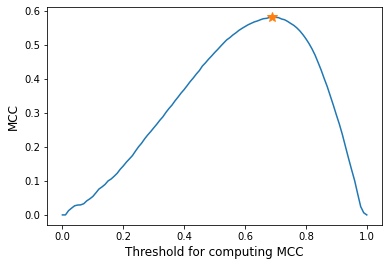

In [22]:
fs = 12
plt.plot(thresholds, mccs)
plt.plot([best_thresh], [max_mcc], '*', ms=10)
plt.xlabel('Threshold for computing MCC', fontsize=fs)
plt.ylabel('MCC', fontsize=fs)
plt.show()

In [24]:
max_mcc

0.5812789497806418

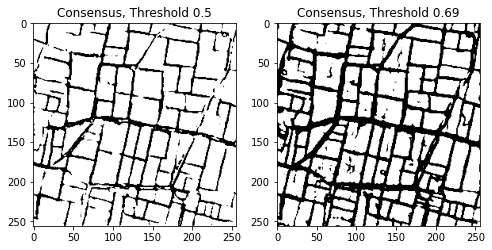

In [26]:
fig, ax = plt.subplots(1, 2, figsize=(8,4))

ax[0].imshow(consensus > 0.5, cmap='Greys_r', vmin=0, vmax=1)
ax[0].set_title('Consensus, Threshold 0.5')

ax[1].imshow(consensus > 0.69, cmap='Greys_r', vmin=0, vmax=1)
ax[1].set_title('Consensus, Threshold 0.69')

plt.show()

# Temp place for Africa results

### Senegal

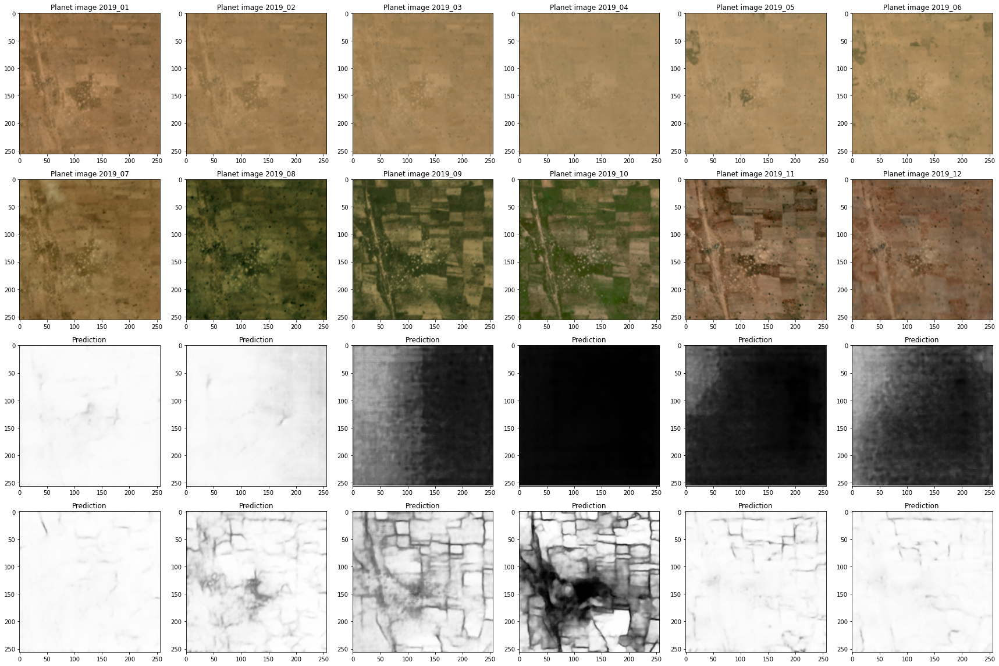

In [130]:
year = 2019
img_dir = '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/'
pred_dir = '../results/senegal/resunet-d6_2019_10_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_1x-8x-downsampled/planet/'
img_names = os.listdir(os.path.join(img_dir, '{}_01'.format(year)))
img_names = [x.split('_')[0] for x in img_names]
random_image_name = np.random.choice(img_names)
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
#     img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
#     img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
#     logits, bound, dist, convc = model(img)
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

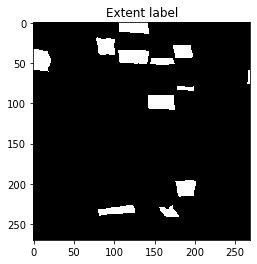

In [131]:
label = imageio.imread('../data/planet/senegal/extent_labels/{}.png'.format(random_image_name))
plt.imshow(label, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
plt.title('Extent label')
plt.show()

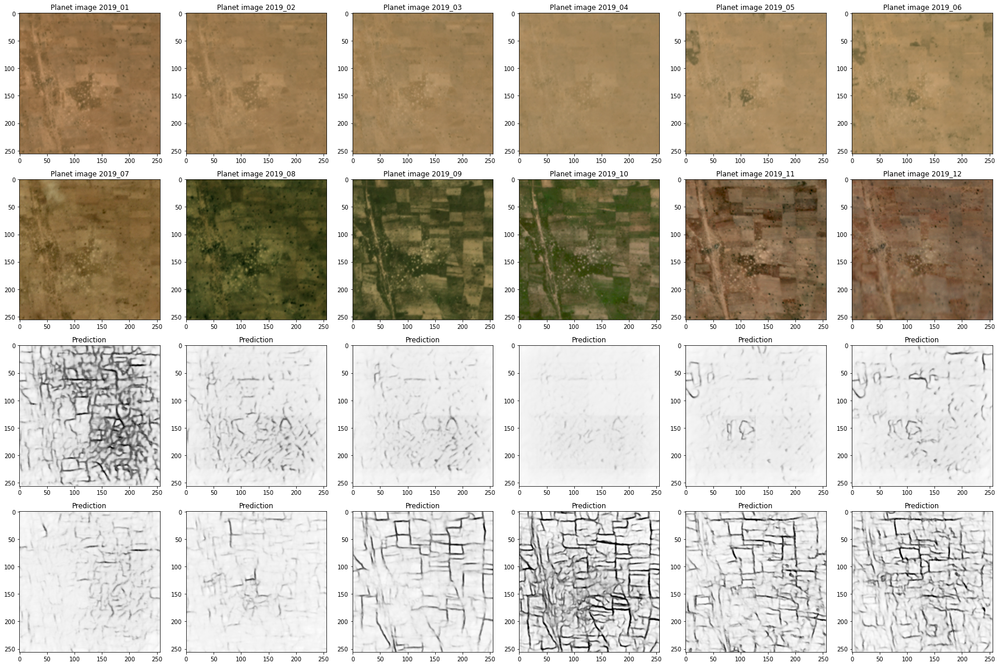

In [132]:
year = 2019
img_dir = '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/'
pred_dir = '../results/senegal/resunet-d6_2019_10_nfilter-16_bs-8_lr-0.001_4x-downsampled_allfield_n6759/planet/'
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

In [44]:
# tune threshold
country = 'senegal'
codes_to_keep = [1]
batch_size = 8
ctx_name = 'gpu'
gpu_id = 3
boundary_kernel_size = (2,2)

if country == 'senegal':
    months = ['2019_09', '2019_10', '2019_11']
    month_name = 'sepOctNov'
    splits_path = '../data/splits/senegal_planetImagery_splits_tiles_overlap.csv'
elif country == 'malawi':
    months = ['2018_01', '2018_02', '2018_03']
    month_name = 'janFebMar'
    splits_path = '../data/splits/malawi_planetImagery_splits_tiles_overlap.csv'
elif country == 'ghana-udry':
    months = ['2017_02', '2017_06', '2017_10']
    month_name = 'febJunOct'
    splits_path = '../data/splits/ghana-udry_planetImagery_splits_tiles_overlap.csv'
splits_df = pd.read_csv(splits_path, dtype=str)

# get all img and labels
all_img_names = []
all_label_names = []
if country == 'senegal' or country == 'malawi':
    img_dir = '../data/planet/{}/monthly_mosaics_renamed_clipped_merged/'.format(country)
    label_dir = '../data/planet/{}/extent_labels/'.format(country)
elif country == 'ghana-udry':
    img_dir = '../data/planet/ghana/udry/monthly_mosaics_renamed_clipped_merged/'
    label_dir = '../data/planet/ghana/udry/extent_labels/'

label_folder_imgs = sorted(os.listdir(label_dir))
for month in months:
    for label_name in label_folder_imgs:
        img_name = label_name.split('.')[0] + '_' + month + '.tif'
        img_path = os.path.join(img_dir, month, img_name)
        all_img_names.append(img_path)
        label_path = os.path.join(label_dir, label_name)
        all_label_names.append(label_path)

# split imgs and labels into train/val/test
all_images = pd.DataFrame({'img_path': all_img_names})
all_images['image_id'] = all_images['img_path'].str.split('/').apply(
    lambda x: x[-1]).str.split('.').apply(
    lambda x: x[0]).str.split('_').apply(
    lambda x: x[0])
all_images = all_images.merge(splits_df[['image_id', 'fold']], on='image_id', how='left')
train_names = all_images[all_images['fold'] == 'train']['img_path'].values
val_names = all_images[all_images['fold'] == 'val']['img_path'].values
test_names = all_images[all_images['fold'] == 'test']['img_path'].values

all_labels = pd.DataFrame({'label_path': all_label_names})
all_labels['image_id'] = all_labels['label_path'].str.split('/').apply(
    lambda x: x[-1]).str.split('.').apply(
    lambda x: x[0])
all_labels = all_labels.merge(splits_df[['image_id', 'fold']], on='image_id', how='left')
train_names_label = all_labels[all_labels['fold'] == 'train']['label_path'].values
val_names_label = all_labels[all_labels['fold'] == 'val']['label_path'].values
test_names_label = all_labels[all_labels['fold'] == 'test']['label_path'].values

In [47]:
train_names_label

array(['../data/planet/senegal/extent_labels/00060.png',
       '../data/planet/senegal/extent_labels/00141.png',
       '../data/planet/senegal/extent_labels/00142.png', ...,
       '../data/planet/senegal/extent_labels/14534.png',
       '../data/planet/senegal/extent_labels/14535.png',
       '../data/planet/senegal/extent_labels/14537.png'], dtype=object)

In [50]:
sample_train

array(['../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/01250_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/04271_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/11823_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/11825_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/01570_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/00304_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/09667_2019_11.tif',
       '../data/planet/senegal/monthly_mosaics_renamed_clipped_merged/2019_11/03684_2019_11.tif'],
      dtype=object)

In [66]:
np.array([[1,0,0], 
          [0,1,0], 
          [0,0,1]])[[0,1,1,2], 
                    [0,0,1,1]]

array([1, 0, 1, 0])

In [133]:
results_dir = '../results/senegal/resunet-d6_2019_10_nfilter-16_bs-8_lr-0.001_4x-downsampled_allfield_n6759/planet/'
thresholds = np.linspace(0, 1, 101)
n_samples = batch_size*5
mccs = {m: np.zeros((len(thresholds), n_samples)) for m in months}

for month in months:
    month_idx = np.array([i for i, x in enumerate(train_names) if month in x])
    train_names_month = train_names[month_idx]
    label_names_month = train_names_label[month_idx]
    
    idx = np.random.choice(np.arange(len(train_names_month)), n_samples, replace=False)
    sample_train = train_names_month[idx]
    sample_label = label_names_month[idx]
    
    train_dataset = PlanetDatasetWithClassesFullPathsMasked(
        fold='train', 
        image_names=sample_train, 
        label_names=sample_label, 
        classes=codes_to_keep,
        boundary_kernel_size=boundary_kernel_size)

    train_dataloader = gluon.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
    
    for batch_i, (_, extent, _, _, _, mask) in enumerate(train_dataloader):

        extent = extent.asnumpy()
        mask = mask.asnumpy()
        
        for i, extent_i in enumerate(extent):
            mask_i = mask[i]
            image_id = sample_train[i+batch_i*batch_size].split('/')[-1].split('_')[0]
            pred = np.load(os.path.join(results_dir, month, 'extent_predictions', image_id+'.npy'))
            
            nonmask_idx = np.argwhere(mask_i[0])
            extent_masked = extent_i[0][nonmask_idx[:,0], nonmask_idx[:,1]]
            pred_masked = pred[nonmask_idx[:,0], nonmask_idx[:,1]]
            
            for t, thresh in enumerate(thresholds):
                mcc = matthews_corrcoef(extent_masked, pred_masked > thresh)
                mccs[month][t, i] = mcc

/home/swang222/anaconda3/envs/mxnet1.6.0/lib/python3.6/site-packages/sklearn/metrics/_classification.py:846: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


In [118]:
thresholds[np.argmax(mccs['2019_11'].mean(axis=1))]

0.9500000000000001

In [119]:
np.argmax(mccs['2019_11'].mean(axis=1))

95

In [120]:
np.mean(mccs['2019_11'][np.argmax(mccs['2019_11'].mean(axis=1))])

0.011815239313330778

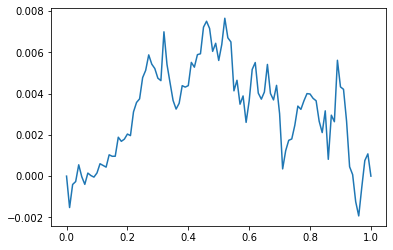

In [137]:
plt.plot(thresholds, mccs['2019_10'].mean(axis=1))

In [ ]:
val_dataset = PlanetDatasetWithClassesFullPathsMasked(
    fold='val', 
    image_names=val_names, 
    label_names=val_names_label, 
    classes=codes_to_keep,
    boundary_kernel_size=boundary_kernel_size)
val_dataloader = gluon.data.DataLoader(val_dataset, batch_size=batch_size)

### Malawi

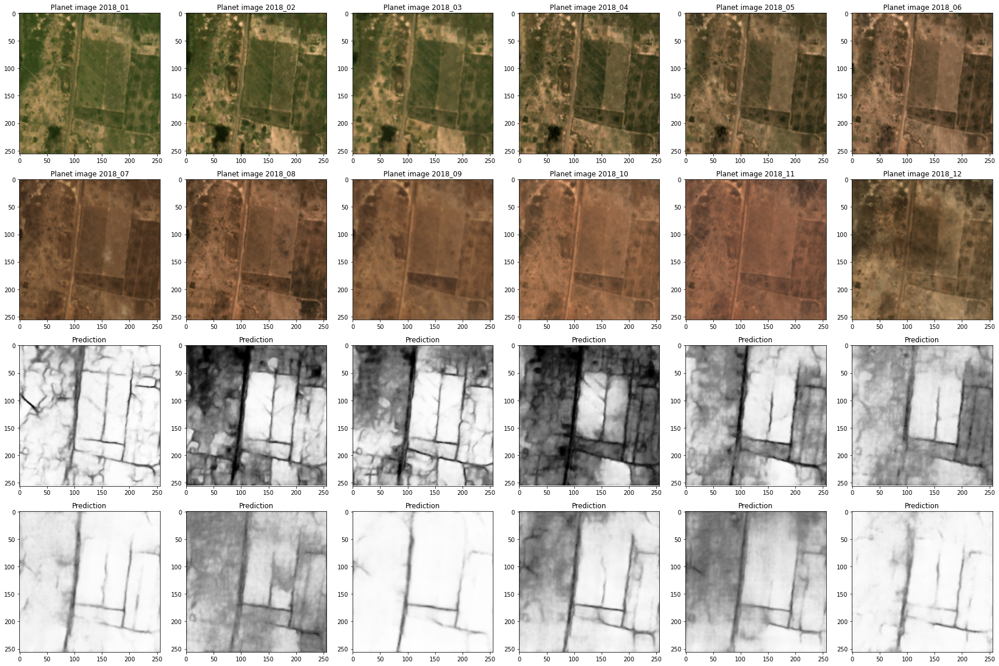

In [37]:
year = 2018
img_dir = '../data/planet/malawi/monthly_mosaics_renamed_clipped_merged/'
pred_dir = '../results/malawi/resunet-d6_2019_10_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_1x-8x-downsampled/planet/'
img_names = os.listdir(os.path.join(img_dir, '{}_01'.format(year)))
img_names = [x.split('_')[0] for x in img_names]
random_image_name = np.random.choice(img_names)
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
#     img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
#     img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
#     logits, bound, dist, convc = model(img)
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

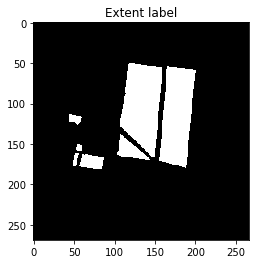

In [38]:
label = imageio.imread('../data/planet/malawi/extent_labels/{}.png'.format(random_image_name))
plt.imshow(label, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
plt.title('Extent label')
plt.show()

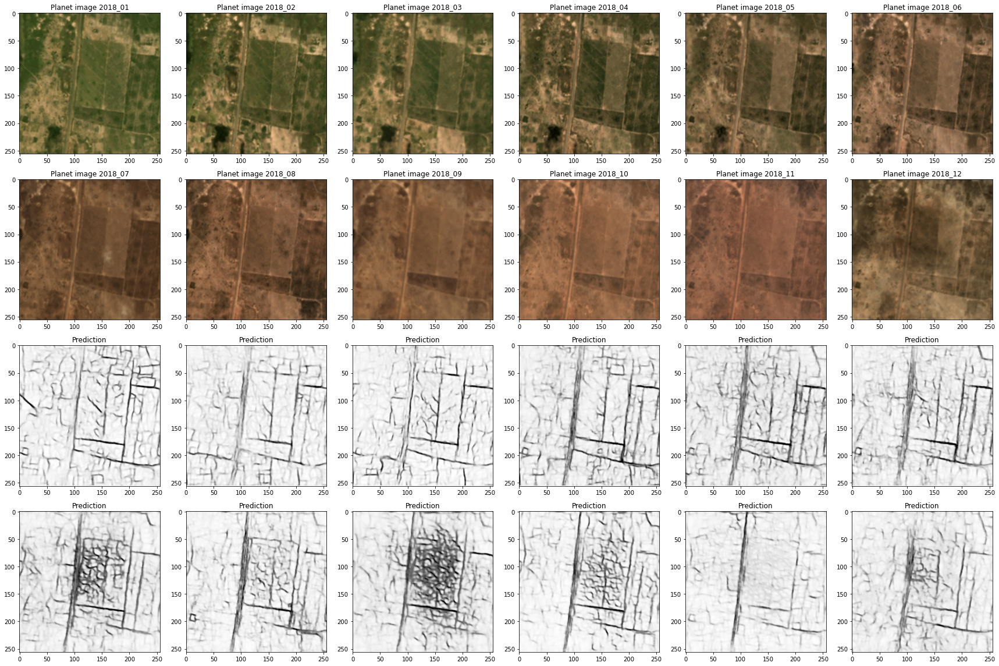

In [108]:
year = 2018
img_dir = '../data/planet/malawi/monthly_mosaics_renamed_clipped_merged/'
pred_dir = '../results/malawi/resunet-d6_2019_10_nfilter-16_bs-8_lr-0.001_4x-downsampled_allfield_n6759/planet/'
img_names = os.listdir(os.path.join(img_dir, '{}_01'.format(year)))
img_names = [x.split('_')[0] for x in img_names]
random_image_name = np.random.choice(img_names)
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
#     img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
#     img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
#     logits, bound, dist, convc = model(img)
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

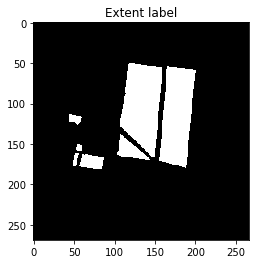

In [109]:
label = imageio.imread('../data/planet/malawi/extent_labels/{}.png'.format(random_image_name))
plt.imshow(label, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
plt.title('Extent label')
plt.show()

## Ghana

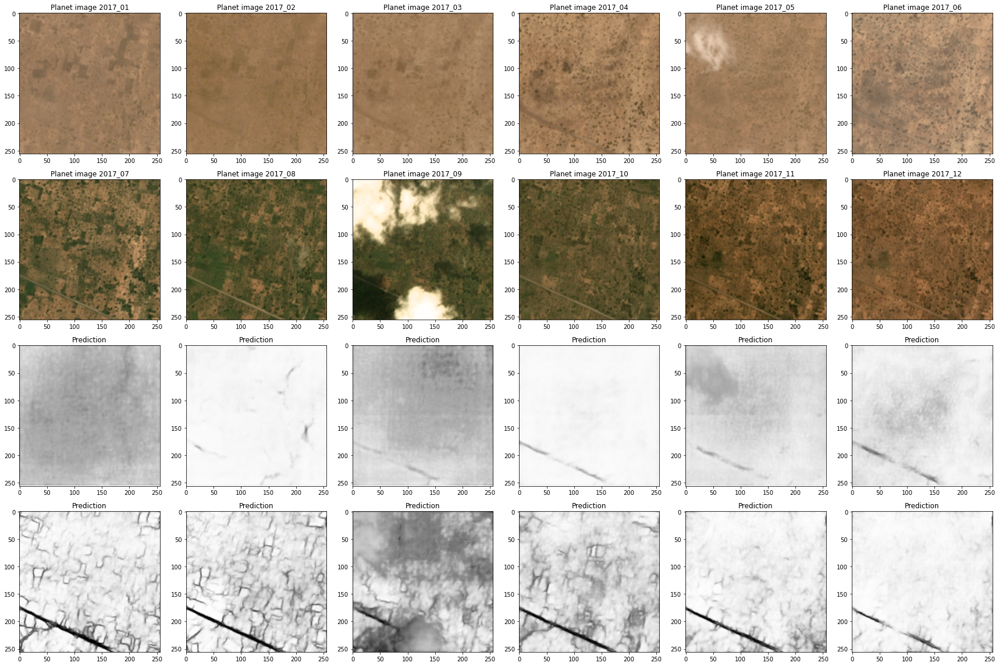

In [141]:
year = 2017
img_dir = '../data/planet/ghana/udry/monthly_mosaics_renamed_clipped_merged/'
pred_dir = '../results/ghana/udry/resunet-d6_2019_10_class-notreeexceptvines_nfilter-16_bs-8_lr-0.001_1x-8x-downsampled//planet/'
img_names = os.listdir(os.path.join(img_dir, '{}_01'.format(year)))
img_names = [x.split('_')[0] for x in img_names]
random_image_name = np.random.choice(img_names)
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
#     img = np.moveaxis(np.expand_dims(random_image, 0), -1, 1)
#     img = mx.nd.array(img).as_in_context(mx.gpu(gpu))
#     logits, bound, dist, convc = model(img)
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()

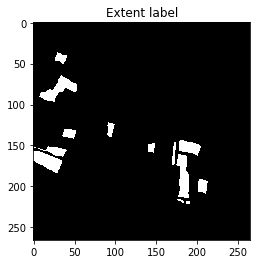

In [142]:
label = imageio.imread('../data/planet/ghana/udry/extent_labels/{}.png'.format(random_image_name))
plt.imshow(label, cmap='Greys_r', interpolation='nearest', vmin=0, vmax=1)
plt.title('Extent label')
plt.show()

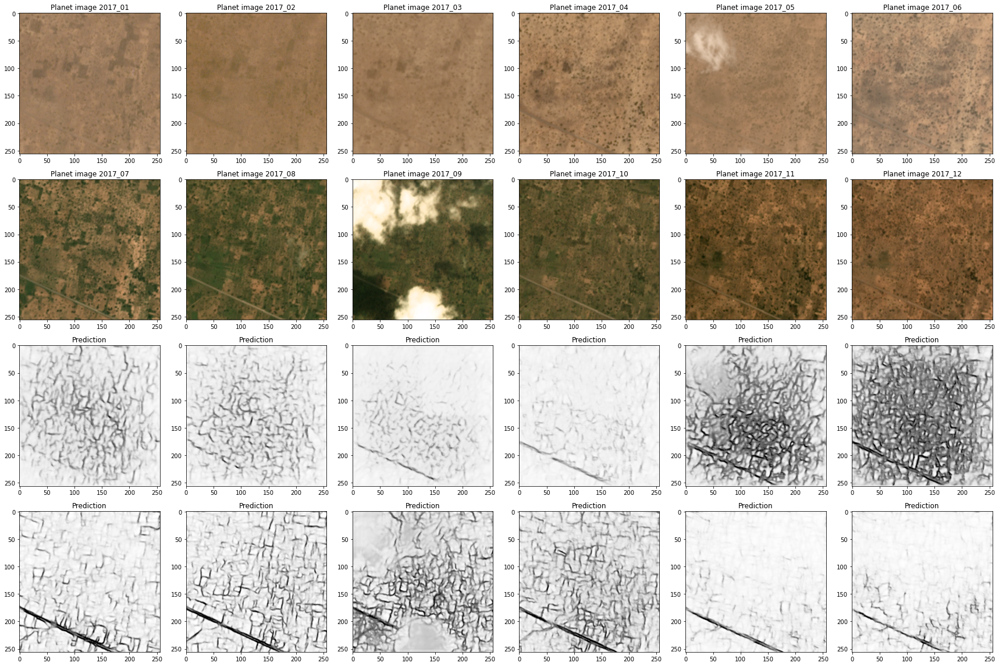

In [143]:
pred_dir = '../results/ghana/udry/resunet-d6_2019_10_nfilter-16_bs-8_lr-0.001_4x-downsampled_allfield_n6759/planet/'
month_dirs = ['{}_{}'.format(year, str(x+1).zfill(2)) for x in range(12)]

fig, ax = plt.subplots(4, 6, figsize=(24, 16))
for m, month in enumerate(month_dirs):
    random_image = imageio.imread(os.path.join(img_dir, month, random_image_name + '_' + month + '.tif'))[:256,:256,:3]
    random_pred = np.load(os.path.join(pred_dir, month, 'extent_predictions', random_image_name + '.npy'))
    
    i = m // 6
    j = m % 6
    ax[i,j].imshow(random_image)
    ax[i,j].set_title('Planet image {}'.format(month))
    
    ax[i+2,j].imshow(random_pred, vmin=0, vmax=1, cmap='Greys_r')
    ax[i+2,j].set_title('Prediction')
    
plt.tight_layout()
plt.show()